# Handling Missing Values

In [1]:
# Load libraries

%load_ext autoreload
%autoreload 2
%matplotlib inline

import pandas as pd
import numpy as np
import datetime as dt
from datetime import date
import gc
from src.functions import data_exploration as dexp
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import pandas_profiling

import chart_studio as cs
from chart_studio import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
cf.set_config_file(offline=True)

init_notebook_mode()

## Loading data

In [2]:
%store -r building_meta_df
%store -r weather_train_df
%store -r train_df

## Missing values in `weather_train_df`

As we saw in the initial EDA, for `weather_train_df`:

* `site_id`--> Ignored for analysis.
* `precip_depth_1hr` is completely missing --> Ignored for analysis.
* `cloud_coverage` has about 80% of missing values --> Ignored for analysis. 
* There're 52 missing values in `sea_level_pressure` (0.6%) --> Impute missing values.
* There's 1 missing value in `air_temperature` and `dew_temperature` --> Impute missing values.
* There're 3 missing values in `wind_direction` --> Impute missing values.
* There's no missing values in `wind_speed`

We'll use `interpolate()` function to impute missing values as we have an hourly time serie, so it is a good aproximation to consider weather parameter values don't change too much between consecutive hours. Our previous tests demonstrated that the best method of `interpolate()` among all tested was `time` method.

In [3]:
# make index 'timestamp'
weather_train_df.index = weather_train_df['timestamp']
del weather_train_df['timestamp']

In [4]:
# Plot time series
weather_train_df[
    [
        'air_temperature',
        'dew_temperature',
        'sea_level_pressure',
        'wind_direction',
        'wind_speed'
    ]
].iplot(kind='scatter', filename='cufflinks/cf-simple-line')

Let's create a function to find the timestamp of the NaN value for each column.

In [4]:
def show_nan(df):
    results = {}
    for col in df.columns:
        results[col] = df[col][df[col].isna()]
               
    return results


### Variable `air_temperature` 

In [5]:
show_nan(weather_train_df).get('air_temperature')

timestamp
2016-10-18 13:00:00   NaN
Name: air_temperature, dtype: float16

In [6]:
air_temp_nans = weather_train_df.index[weather_train_df['air_temperature'].isna()].tolist()

In [7]:
weather_train_df['air_temperature'].interpolate(method='time', inplace=True)

In [8]:
weather_train_df.loc[air_temp_nans, 'air_temperature']

timestamp
2016-10-18 13:00:00    13.398438
Name: air_temperature, dtype: float16

### Variable `dew_temperature` 

In [9]:
show_nan(weather_train_df).get('dew_temperature')

timestamp
2016-10-18 13:00:00   NaN
Name: dew_temperature, dtype: float16

In [10]:
dew_temp_nans = weather_train_df.index[weather_train_df['dew_temperature'].isna()].tolist()

In [11]:
weather_train_df['dew_temperature'].interpolate(method='time', inplace=True)

In [12]:
weather_train_df.loc[dew_temp_nans, 'dew_temperature']

timestamp
2016-10-18 13:00:00    4.351562
Name: dew_temperature, dtype: float16

### Variable `sea_level_pressure`

In [15]:
show_nan(weather_train_df).get('sea_level_pressure')

timestamp
2016-01-09 06:00:00   NaN
2016-01-12 05:00:00   NaN
2016-01-12 06:00:00   NaN
2016-01-15 11:00:00   NaN
2016-01-30 11:00:00   NaN
2016-02-13 07:00:00   NaN
2016-02-23 05:00:00   NaN
2016-03-18 14:00:00   NaN
2016-03-19 15:00:00   NaN
2016-03-28 05:00:00   NaN
2016-03-28 06:00:00   NaN
2016-04-18 05:00:00   NaN
2016-04-23 17:00:00   NaN
2016-05-02 01:00:00   NaN
2016-05-04 12:00:00   NaN
2016-05-08 00:00:00   NaN
2016-05-08 17:00:00   NaN
2016-05-16 14:00:00   NaN
2016-05-27 16:00:00   NaN
2016-05-28 05:00:00   NaN
2016-06-06 12:00:00   NaN
2016-06-13 05:00:00   NaN
2016-06-30 13:00:00   NaN
2016-07-09 04:00:00   NaN
2016-07-09 08:00:00   NaN
2016-07-22 20:00:00   NaN
2016-07-29 04:00:00   NaN
2016-07-30 15:00:00   NaN
2016-08-02 14:00:00   NaN
2016-08-09 17:00:00   NaN
2016-08-12 22:00:00   NaN
2016-08-13 07:00:00   NaN
2016-08-14 01:00:00   NaN
2016-08-20 09:00:00   NaN
2016-08-23 14:00:00   NaN
2016-09-05 17:00:00   NaN
2016-09-06 16:00:00   NaN
2016-09-10 05:00:00   NaN
20

In [13]:
pressure_nans = weather_train_df.index[weather_train_df['sea_level_pressure'].isna()].tolist()

In [14]:
weather_train_df['sea_level_pressure'].interpolate(method='time', inplace=True)

In [15]:
weather_train_df.loc[pressure_nans, 'sea_level_pressure']

timestamp
2016-01-09 06:00:00     994.5
2016-01-12 05:00:00     994.0
2016-01-12 06:00:00     994.5
2016-01-15 11:00:00    1020.0
2016-01-30 11:00:00    1009.5
2016-02-13 07:00:00     987.0
2016-02-23 05:00:00    1014.0
2016-03-18 14:00:00    1026.0
2016-03-19 15:00:00    1026.0
2016-03-28 05:00:00     977.5
2016-03-28 06:00:00     978.5
2016-04-18 05:00:00    1021.0
2016-04-23 17:00:00    1021.0
2016-05-02 01:00:00    1024.0
2016-05-04 12:00:00    1026.0
2016-05-08 00:00:00    1007.0
2016-05-08 17:00:00    1006.5
2016-05-16 14:00:00    1021.0
2016-05-27 16:00:00    1016.0
2016-05-28 05:00:00    1016.5
2016-06-06 12:00:00    1021.5
2016-06-13 05:00:00    1003.5
2016-06-30 13:00:00    1010.0
2016-07-09 04:00:00    1019.0
2016-07-09 08:00:00    1018.0
2016-07-22 20:00:00    1019.0
2016-07-29 04:00:00    1011.0
2016-07-30 15:00:00    1013.5
2016-08-02 14:00:00    1010.0
2016-08-09 17:00:00    1024.0
2016-08-12 22:00:00    1023.0
2016-08-13 07:00:00    1023.0
2016-08-14 01:00:00    1024.0


### Variable `wind_direction`

In [16]:
show_nan(weather_train_df).get('wind_direction')

timestamp
2016-07-30 15:00:00   NaN
2016-10-07 07:00:00   NaN
2016-10-25 13:00:00   NaN
Name: wind_direction, dtype: float16

In [17]:
wind_dir_nans = weather_train_df.index[weather_train_df['wind_direction'].isna()].tolist()
weather_train_df['wind_direction'].interpolate(method='time', inplace=True)
weather_train_df.loc[wind_dir_nans, 'wind_direction']

timestamp
2016-07-30 15:00:00    305.0
2016-10-07 07:00:00     75.0
2016-10-25 13:00:00     50.0
Name: wind_direction, dtype: float16

### Variables `site_id`, `precip_depth_1_hr` and `cloud_coverage`

As mentioned above, these three variable are being igonored and dropped from the data frame.

In [21]:
weather_train_df.drop(columns=['site_id','precip_depth_1_hr','cloud_coverage'], inplace=True)

Finally, let's restore the index timestamp to a regular column, as we will consider it as a feature.

In [22]:
weather_train_df.reset_index(inplace=True)

In [23]:
weather_train_df.head()

,timestamp,air_temperature,dew_temperature,sea_level_pressure,wind_direction,wind_speed
0,2016-01-01 00:00:00,3.800781,2.400391,1021.0,240.0,3.099609
1,2016-01-01 01:00:00,3.699219,2.400391,1021.5,230.0,2.599609
2,2016-01-01 02:00:00,2.599609,1.900391,1022.0,0.0,0.000000
3,2016-01-01 03:00:00,2.000000,1.200195,1022.5,170.0,1.500000
4,2016-01-01 04:00:00,2.300781,1.799805,1022.5,110.0,1.500000


In [24]:
weather_train_df.to_csv('../../data/interim/site_1/processed/clean_weather.csv')

## Missing values in `building_meta_df`

As we saw in the initial EDA, for `building_meta_df`:
* `site_id`--> Ignored for analysis
* `building_id`--> It's a label to identify each building. Ignored for analysis
* `year_built`--> There are 11 missing values (22% aprox.)

From `year_built` we'll create a new feature named `building_age` in order to deal with numeric values rather than datetime types.

In [19]:
# create building_age feature and drop year_built
from datetime import date

current_year = int(date.today().year)
building_meta_df['building_age'] = current_year - building_meta_df['year_built']
H
# drop no needed columns
building_meta_df.drop(columns=['site_id','year_built'], inplace=True)

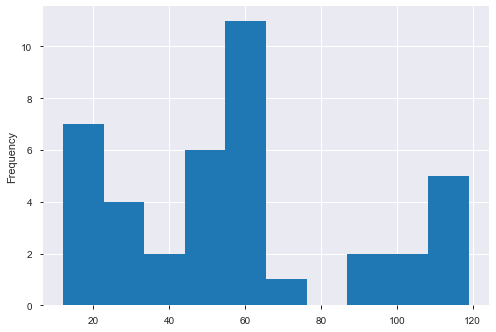

In [26]:
building_meta_df['building_age'].plot.hist()

In [27]:
building_meta_df['building_age'].describe()

count     40.000000
mean      57.525000
std       31.795006
min       12.000000
25%       29.500000
50%       59.000000
75%       64.500000
max      119.000000
Name: building_age, dtype: float64

Now we'll impute missing values in `building_age`. In this case, a good choice is to fill them in with the mean or the median. The median is more robust, i.e., it gets less affected by outliers, so our choice is to use the median. 

In [28]:
age_median = np.median(building_meta_df['building_age'])
building_meta_df.building_age = building_meta_df.building_age.fillna(age_median)

In [29]:
building_meta_df.isna().sum()

building_id     0
primary_use     0
square_feet     0
floor_count     0
building_age    0
dtype: int64

building_meta_df.head()

In [30]:
# export pre-processed building_meta_df 
building_meta_df.to_csv('../../data/interim/site_1/processed/building_clean.csv')

## Merging data sets

We'll make two data frames, one (`df1`) merging the previous data sets with imputed missing values, and another (`df2`) using the data frames with no missing values imputation for variable `cloud_coverage` in the weather data, and for variable `building_age` in the buldings data. The aim is to check whether the chosen missing values imputation methods  are suitable or we may need to choose others.

### Merge 1: creating `df1`

In [31]:
# train + building by FK 'building_id'
merge_1 = pd.merge(train_df, building_meta_df, how='left', on='building_id')
merge_1.head()

,building_id,meter,timestamp,meter_reading,primary_use,square_feet,floor_count,building_age
0,105,0,2016-01-01 00:00:00,23.296875,Education,50623,5,54
1,105,0,2016-01-01 01:00:00,45.593750,Education,50623,5,54
2,105,0,2016-01-01 02:00:00,45.593750,Education,50623,5,54
3,105,0,2016-01-01 03:00:00,45.093750,Education,50623,5,54
4,105,0,2016-01-01 04:00:00,45.593750,Education,50623,5,54


In [32]:
merge_1.shape

(553357, 8)

In [33]:
# merge_1 + weather_train by timestamp
df1 = pd.merge(merge_1, weather_train_df, how='left', on='timestamp')
df1.head()

,building_id,meter,timestamp,meter_reading,primary_use,square_feet,floor_count,building_age,air_temperature,dew_temperature,sea_level_pressure,wind_direction,wind_speed
0,105,0,2016-01-01 00:00:00,23.296875,Education,50623,5,54,3.800781,2.400391,1021.0,240.0,3.099609
1,105,0,2016-01-01 01:00:00,45.593750,Education,50623,5,54,3.699219,2.400391,1021.5,230.0,2.599609
2,105,0,2016-01-01 02:00:00,45.593750,Education,50623,5,54,2.599609,1.900391,1022.0,0.0,0.000000
3,105,0,2016-01-01 03:00:00,45.093750,Education,50623,5,54,2.000000,1.200195,1022.5,170.0,1.500000
4,105,0,2016-01-01 04:00:00,45.593750,Education,50623,5,54,2.300781,1.799805,1022.5,110.0,1.500000


In [34]:
df1.profile_report(
    title='Merged data frames report `df1`', 
    style={'full_width':True}
)

We see in the previous report that, despite of having imputed missing values in the separate data frames, there're 1323 missing values in the merged set. This is because there're timestamp indexes that exist in `train_df` but don't in `weather_train_df`. Let's see it:

- We'd expect timestamp unique values array for `train_df` and `weather_train_df` to be equal, but they are not.

In [35]:
ts_weather_array = weather_train_df['timestamp'].unique()
ts_train_array = train_df['timestamp'].unique()

In [36]:
ts_diff = np.setdiff1d(ts_train_array, ts_weather_array)
ts_diff

array(['2016-02-15T14:00:00.000000000', '2016-02-15T15:00:00.000000000',
       '2016-02-15T16:00:00.000000000', '2016-02-15T17:00:00.000000000',
       '2016-02-15T20:00:00.000000000', '2016-02-18T12:00:00.000000000',
       '2016-02-18T15:00:00.000000000', '2016-02-18T16:00:00.000000000',
       '2016-02-18T17:00:00.000000000', '2016-02-18T18:00:00.000000000',
       '2016-02-18T19:00:00.000000000', '2016-03-22T23:00:00.000000000',
       '2016-03-23T00:00:00.000000000', '2016-03-23T01:00:00.000000000',
       '2016-03-23T02:00:00.000000000', '2016-03-23T13:00:00.000000000',
       '2016-04-07T15:00:00.000000000', '2016-09-29T08:00:00.000000000',
       '2016-11-23T00:00:00.000000000', '2016-11-23T01:00:00.000000000',
       '2016-11-23T11:00:00.000000000'], dtype='datetime64[ns]')

In [37]:
weather_train_df[
    weather_train_df['timestamp'].isin(ts_diff)
]

,timestamp,air_temperature,dew_temperature,sea_level_pressure,wind_direction,wind_speed


####  Imputing missing values in `df1`

In [38]:
mask = df1['timestamp'].isin(ts_diff)
df1.loc[mask]

,building_id,meter,timestamp,meter_reading,primary_use,square_feet,floor_count,building_age,air_temperature,dew_temperature,sea_level_pressure,wind_direction,wind_speed
1094,105,0,2016-02-15 14:00:00,134.6250,Education,50623,5,54,NaN,NaN,NaN,NaN,NaN
1095,105,0,2016-02-15 15:00:00,134.0000,Education,50623,5,54,NaN,NaN,NaN,NaN,NaN
1096,105,0,2016-02-15 16:00:00,135.7500,Education,50623,5,54,NaN,NaN,NaN,NaN,NaN
1097,105,0,2016-02-15 17:00:00,132.3750,Education,50623,5,54,NaN,NaN,NaN,NaN,NaN
1100,105,0,2016-02-15 20:00:00,84.7500,Education,50623,5,54,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
546916,155,0,2016-04-07 15:00:00,87.8750,Office,51688,8,89,NaN,NaN,NaN,NaN,NaN
551109,155,0,2016-09-29 08:00:00,75.2500,Office,51688,8,89,NaN,NaN,NaN,NaN,NaN
552421,155,0,2016-11-23 00:00:00,71.3750,Office,51688,8,89,NaN,NaN,NaN,NaN,NaN
552422,155,0,2016-11-23 01:00:00,54.3125,Office,51688,8,89,NaN,NaN,NaN,NaN,NaN


In [39]:
# make index 'timestamp'
df1.index = df1['timestamp']
del df1['timestamp']

We'll try  also with `time` method of `interpolate()`.

In [40]:
df1_cpy = df1.copy()
            
weather_var_list = [
    'air_temperature',
    'dew_temperature',
    'sea_level_pressure',
    'wind_direction',
    'wind_speed'
]

for var in weather_var_list:
    df1_cpy[var].interpolate(
        method='time', 
        inplace=True
    )

Let's check if the imputed missing values seem reasonable for a sample of `df1_cpy`, for instance, for building 106 and meter 0

In [41]:
sub_df1 = df1.loc[(df1['meter'] == 0) & (df1['building_id'] == 106)]
sub_df1_cpy = df1_cpy.loc[(df1_cpy['meter'] == 0) & (df1_cpy['building_id'] == 106)]

sub_df1_cpy.isna().sum()

building_id           0
meter                 0
meter_reading         0
primary_use           0
square_feet           0
floor_count           0
building_age          0
air_temperature       0
dew_temperature       0
sea_level_pressure    0
wind_direction        0
wind_speed            0
dtype: int64

In [42]:
fig = go.Figure()

for var in weather_var_list:
    fig.add_trace(
        go.Scatter(
            x=sub_df1.index,
            y=sub_df1[var],
            mode="lines",
            name='{}'.format(var),
        )
    )

    fig.add_trace(
        go.Scatter(
            x=sub_df1[sub_df1[var].isna()].index,
            y=sub_df1_cpy[sub_df1_cpy.index.isin(ts_diff)][var], 
            mode="markers",
            name='{} imputed values'.format(var),
        )
    )

fig.show()

The interpolation method used returns pretty reasonable results, so let's generate our final `df1` set with no missing values.

In [43]:
# Reset timestamp index to a column
df1.reset_index(inplace=True)
df1_cpy.reset_index(inplace=True)

In [44]:
# Rearranging columns
cols = [
    'timestamp',
    'building_id', 
    'building_age', 
    'primary_use', 
    'floor_count', 
    'square_feet',
    'meter',  
    'air_temperature', 
    'dew_temperature',
    'sea_level_pressure',
    'wind_direction',
    'wind_speed',
    'meter_reading'
]

df1_cpy = df1_cpy[cols]

In [52]:
df1_cpy.profile_report(
    title='Merged data frames report `df1` no NaNs', 
    style={'full_width':True}
)

In [50]:
df1_cpy.to_csv('../../data/interim/site_1/processed/merged_data_no_nans.csv', index=False)

### Merge 2: creating `df2`

After repeating the previous steps to get the missing values imputed in all the weather variables, except in `cloud_covarage`.

In [18]:
# We don't drop column cloud_coverage this time
weather_train_df.drop(columns=['site_id','precip_depth_1_hr'], inplace=True)

# Restore timestamp as a column
weather_train_df.reset_index(inplace=True)

weather_train_df.head()

,timestamp,air_temperature,cloud_coverage,dew_temperature,sea_level_pressure,wind_direction,wind_speed
0,2016-01-01 00:00:00,3.800781,NaN,2.400391,1021.0,240.0,3.099609
1,2016-01-01 01:00:00,3.699219,0.0,2.400391,1021.5,230.0,2.599609
2,2016-01-01 02:00:00,2.599609,0.0,1.900391,1022.0,0.0,0.000000
3,2016-01-01 03:00:00,2.000000,0.0,1.200195,1022.5,170.0,1.500000
4,2016-01-01 04:00:00,2.300781,0.0,1.799805,1022.5,110.0,1.500000


After repeating the previous steps in `building_meta_df`, except imputing missing values for `building_age`.

In [20]:
# train + building by FK 'building_id'
merge_2 = pd.merge(train_df, building_meta_df, how='left', on='building_id')
merge_2.head()

,building_id,meter,timestamp,meter_reading,primary_use,square_feet,floor_count,building_age
0,105,0,2016-01-01 00:00:00,23.296875,Education,50623,5,NaN
1,105,0,2016-01-01 01:00:00,45.593750,Education,50623,5,NaN
2,105,0,2016-01-01 02:00:00,45.593750,Education,50623,5,NaN
3,105,0,2016-01-01 03:00:00,45.093750,Education,50623,5,NaN
4,105,0,2016-01-01 04:00:00,45.593750,Education,50623,5,NaN


In [30]:
# merge_2 + weather_train by timestamp
df2 = pd.merge(merge_2, weather_train_df, how='left', on='timestamp')
df2.head()

,building_id,meter,timestamp,meter_reading,primary_use,square_feet,floor_count,building_age,air_temperature,cloud_coverage,dew_temperature,sea_level_pressure,wind_direction,wind_speed
0,105,0,2016-01-01 00:00:00,23.296875,Education,50623,5,NaN,3.800781,NaN,2.400391,1021.0,240.0,3.099609
1,105,0,2016-01-01 01:00:00,45.593750,Education,50623,5,NaN,3.699219,0.0,2.400391,1021.5,230.0,2.599609
2,105,0,2016-01-01 02:00:00,45.593750,Education,50623,5,NaN,2.599609,0.0,1.900391,1022.0,0.0,0.000000
3,105,0,2016-01-01 03:00:00,45.093750,Education,50623,5,NaN,2.000000,0.0,1.200195,1022.5,170.0,1.500000
4,105,0,2016-01-01 04:00:00,45.593750,Education,50623,5,NaN,2.300781,0.0,1.799805,1022.5,110.0,1.500000


As explained above, It's required to imput resulting missing values in weather variables after merging:

In [31]:
df2.isna().sum()

building_id                0
meter                      0
timestamp                  0
meter_reading              0
primary_use                0
square_feet                0
floor_count                0
building_age          140530
air_temperature         1323
cloud_coverage        446202
dew_temperature         1323
sea_level_pressure      1323
wind_direction          1323
wind_speed              1323
dtype: int64

In [32]:
df2.index = df2['timestamp']
del df2['timestamp']

weather_var_list = [
    'air_temperature',
    'dew_temperature',
    'sea_level_pressure',
    'wind_direction',
    'wind_speed'
]

for var in weather_var_list:
    df2[var].interpolate(
        method='time', 
        inplace=True
    )
 
df2.reset_index(inplace=True)


In [34]:
# Rearranging columns
cols = [
    'timestamp',
    'building_id', 
    'building_age', 
    'primary_use', 
    'floor_count', 
    'square_feet',
    'meter',  
    'air_temperature', 
    'dew_temperature',
    'sea_level_pressure',
    'wind_direction',
    'wind_speed',
    'cloud_coverage',
    'meter_reading'
]

df2 = df2[cols]
df2.head()

,timestamp,building_id,building_age,primary_use,floor_count,square_feet,meter,air_temperature,dew_temperature,sea_level_pressure,wind_direction,wind_speed,cloud_coverage,meter_reading
0,2016-01-01 00:00:00,105,NaN,Education,5,50623,0,3.800781,2.400391,1021.0,240.0,3.099609,NaN,23.296875
1,2016-01-01 01:00:00,105,NaN,Education,5,50623,0,3.699219,2.400391,1021.5,230.0,2.599609,0.0,45.593750
2,2016-01-01 02:00:00,105,NaN,Education,5,50623,0,2.599609,1.900391,1022.0,0.0,0.000000,0.0,45.593750
3,2016-01-01 03:00:00,105,NaN,Education,5,50623,0,2.000000,1.200195,1022.5,170.0,1.500000,0.0,45.093750
4,2016-01-01 04:00:00,105,NaN,Education,5,50623,0,2.300781,1.799805,1022.5,110.0,1.500000,0.0,45.593750


In [35]:
df2.profile_report(
    title='Merged data frames report `df2` with NaNs', 
    style={'full_width':True}
)

In [36]:
df2.to_csv('../../data/interim/site_1/processed/merged_data_with_nans.csv')


In [58]:
temp_array = np.array(list(df2['air_temperature']))

In [59]:
np.mean(temp_array)

11.700136415725616